In [2]:
import matplotlib.pyplot as plt
import wordcloud
import pandas as pd
from IPython.display import display

In [5]:
places_df = pd.read_csv('../data/places_GP.csv')
df = pd.read_csv('../data/comments_filled_sent.csv')
words = pd.read_csv('../data/words.csv')
bigramms = pd.read_csv('../data/bigramms.csv')

C:\Users\yupes\anaconda3\envs\python-gis\lib\site-packages\IPython\core\interactiveshell.py:3444: DtypeWarning: Columns (1,4) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [32]:
comments_df = pd.read_csv('../data/comments.csv')

C:\Users\yupes\anaconda3\envs\python-gis\lib\site-packages\IPython\core\interactiveshell.py:3444: DtypeWarning: Columns (1,4) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [57]:
comments_df = comments_df.drop_duplicates()

In [61]:
comments_df.shape

(414137, 10)

In [58]:
places_df_sent = places_df.merge(comments_df.groupby('url').count()[['reviewer_page']].reset_index().rename(columns = {'reviewer_page':'count_downloaded'}).merge(df.groupby('url').count().sort_values('index_review')[['index_review']].reset_index().rename(columns = {'index_review':'count_filled'}).merge(
df.loc[df.score>0].groupby('url').count().sort_values('index_review')[['index_review']].reset_index().rename(columns = {'index_review':'count_pos'}), \
how = 'left').merge(df.loc[df.score<0].groupby('url').count().sort_values('index_review')[['index_review']].reset_index().rename(columns = {'index_review':'count_neg'}), how = 'left')
, how = 'left', on = 'url'), how = 'left', on = 'url').copy()

In [59]:
places_df_sent.loc[places_df_sent.count_downloaded==0, 'count_downloaded'] = places_df_sent.loc[places_df_sent.count_downloaded==0, 'count_review']

In [234]:
places_df_sent = places_df_sent.merge(df.groupby('url').median()[['score']].rename(columns = {'score':'median_score'}).reset_index()\
    .merge(df.loc[df.score<0].groupby('url').median()[['score']].rename(columns = {'score':'median_negative'}).reset_index(), how = 'left', on = 'url')\
    .merge(df.loc[df.score>0].groupby('url').median()[['score']].rename(columns = {'score':'median_positive'}).reset_index(), how = 'left', on ='url'), how = 'left', on = 'url')

In [74]:
for i in ['count_review', 'count_downloaded', 'count_filled','count_pos', 'count_neg']:
    places_df_sent[i].fillna(0, inplace = True)

In [77]:
places_df_sent['count_neutral'] = places_df_sent['count_filled']-places_df_sent['count_pos']-places_df_sent['count_neg']

In [235]:
places_df_sent.to_csv('../data/places_GP_sent.csv', index = False)

In [ ]:
# функция для рисования облака слов
def get_cloud(words_list, title, cm):
    stop = ["который", "этот_магазин","вообще", "которое","которые","много","сказал", "ничего","второй_раз","этот_гостиница","этот_церковь", "этот_автобус", "один_место","этот_храм","свой_дело", "такой_ощущение", "этот_парк", "один_сторона", "свой_время", "один_раз", "первый_раз", "этот_отель","данный_магазин", "другой_магазин","какой", "такой", "тот", "если","только", "есть","была", "место", "месте", "было", "были", "тогда","очень", "этот", "другой", "также", "чтобы", "быть", "мочь", "свой", "весь", "один"]

    wc = wordcloud.WordCloud(collocations=True, 
                             background_color = 'white', 
                             width=1600, 
                             height=800, 
                             min_word_length=4, 
                             colormap=cm,
                             stopwords= stop).generate(" ".join(words_list))
    
    plt.figure(figsize=(20,10))
    plt.imshow(wc, interpolation="bilinear")
    plt.title(title)
    plt.axis("off")
    plt.show()

# Анализ слов

In [ ]:
g = ['NOUN','ADJF', 'ADJS', 'COMP','VERB', 'INFN', 'PRTF', 'PRTS', 'GRND', 'ADVB']

In [217]:
words.word.replace('магазине', 'магазин', inplace = True)
words.word.replace('парка', 'парк', inplace = True)
words.word.replace('парке', 'парк', inplace = True)
words.word.replace('моста', 'мост', inplace = True)
words.word.replace('мосту', 'мост', inplace = True)
words.word.replace('детям', 'дети', inplace = True)
words.word.replace('деревьев', 'деревья', inplace = True)
words.word.replace('детьми', 'дети', inplace = True)
words.word.replace('детей', 'дети', inplace = True)
words.word.replace('животных', 'животные', inplace = True)
words.word.replace('клуба', 'клуб', inplace = True)
words.word.replace('номера', 'номер', inplace = True)
words.word.replace('номере', 'номер', inplace = True)
words.word.replace('реки', 'река', inplace = True)
words.word.replace('реку', 'река', inplace = True)
words.word.replace('аттракционов', 'аттракционы', inplace = True)
words.word.replace('врачи', 'врач', inplace = True)
words.word.replace('парка', 'парк', inplace = True)
words.word.replace('краснодара', 'краснодар', inplace = True)
words.word.replace('краснодаре', 'краснодар', inplace = True)
words.word.replace('прогулкок', 'прогулки', inplace = True)
words.word.replace('деревьями', 'деревья', inplace = True)

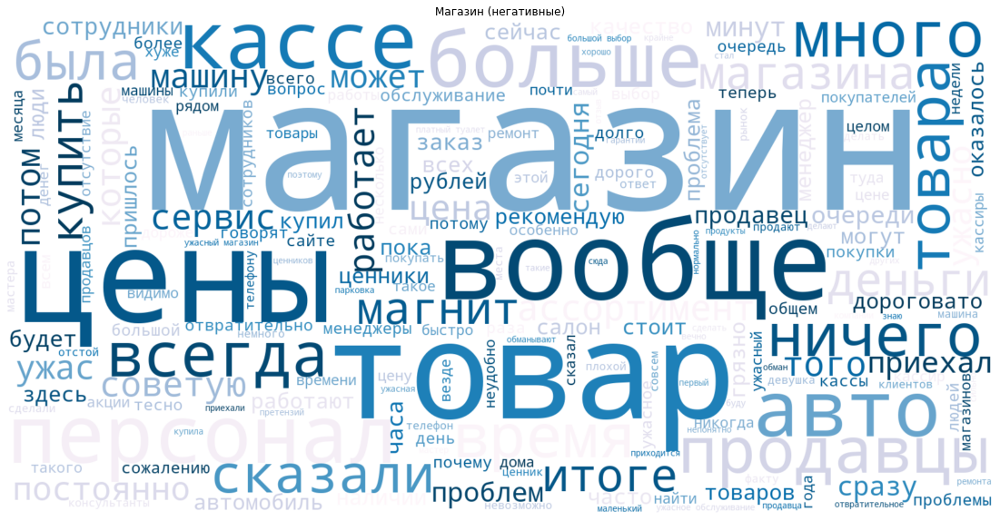

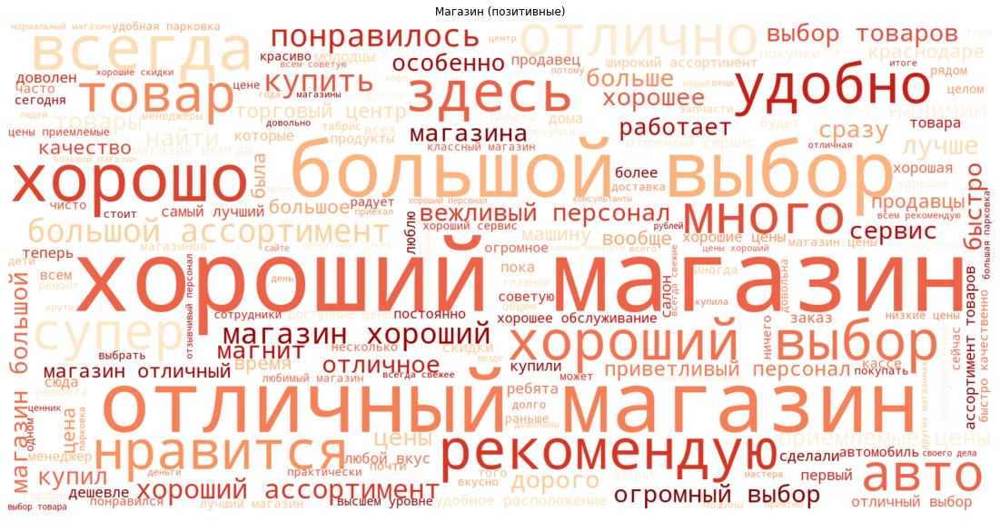

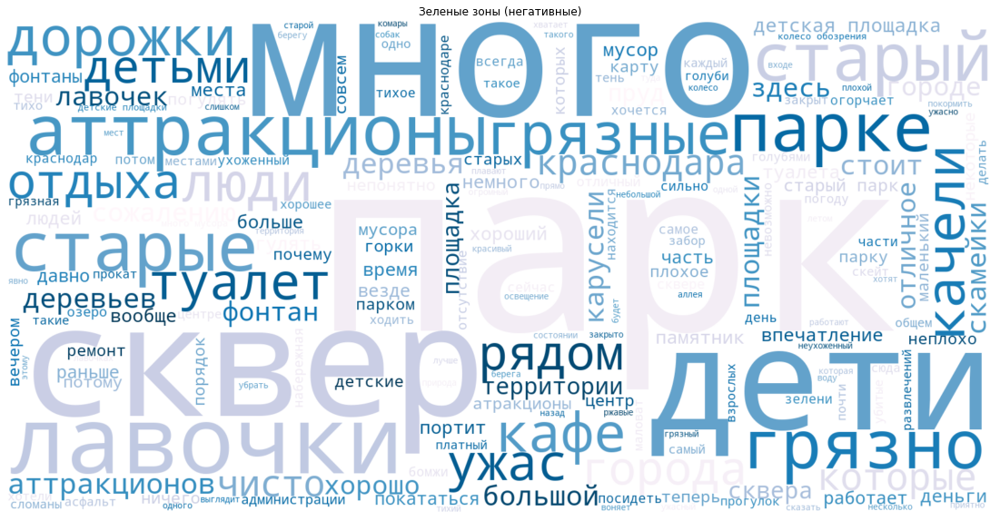

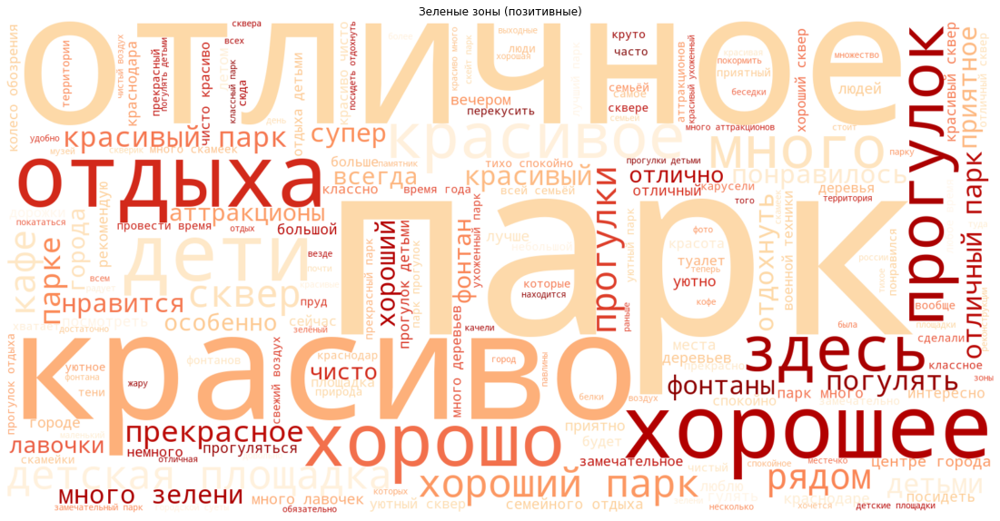

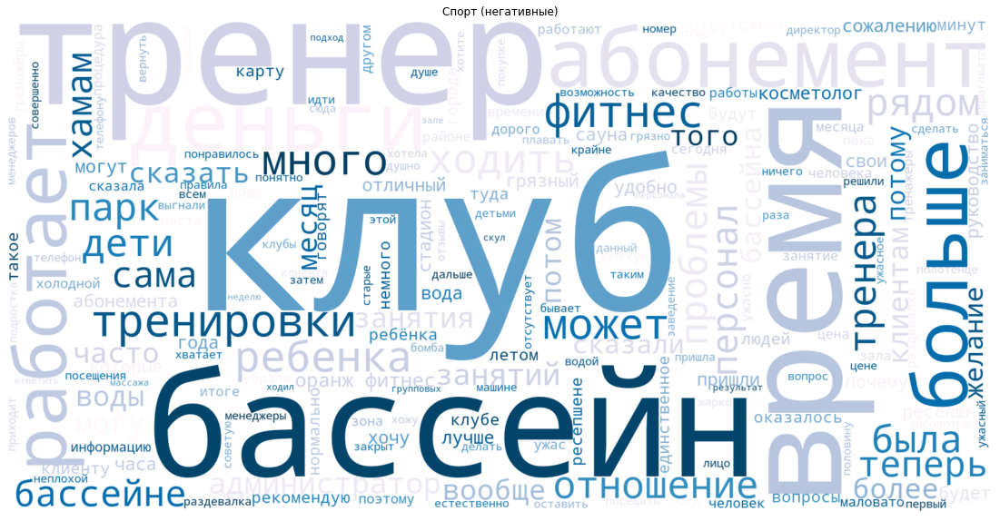

...

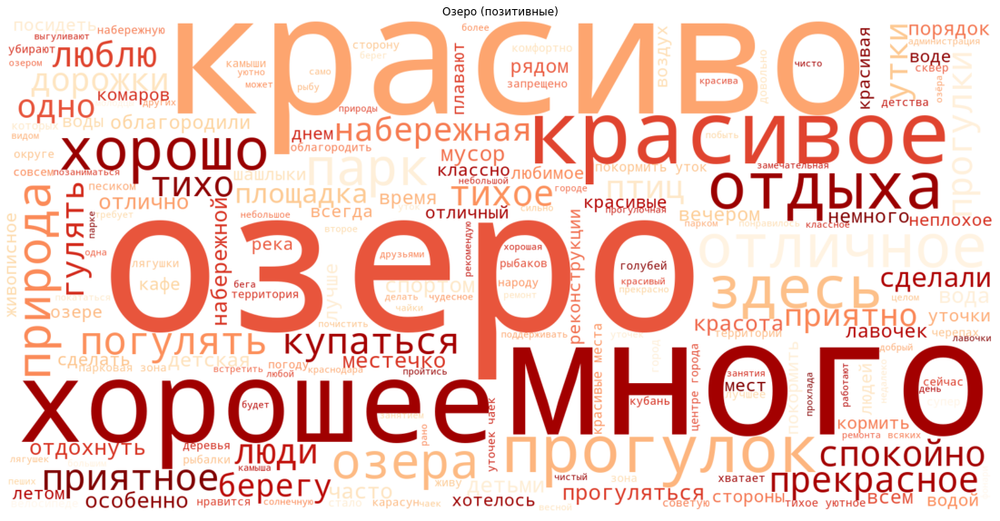

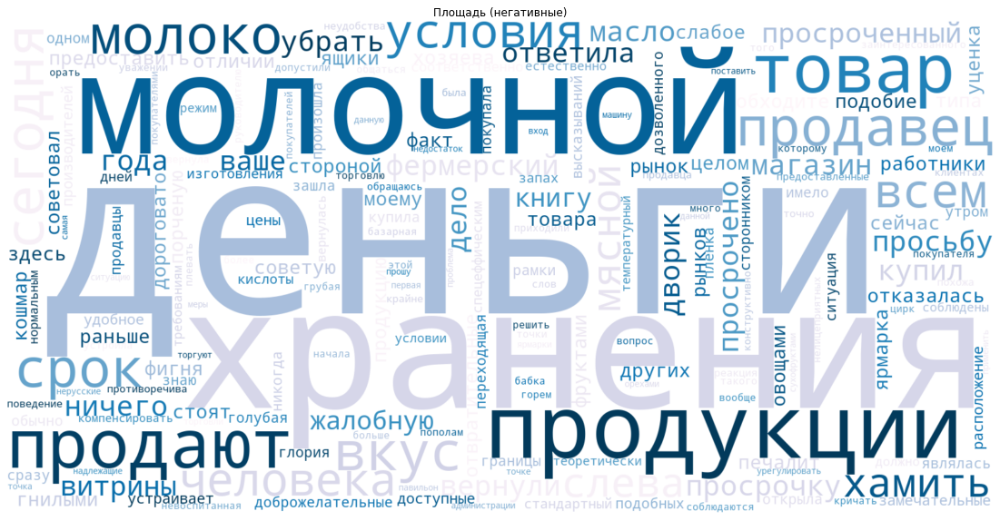

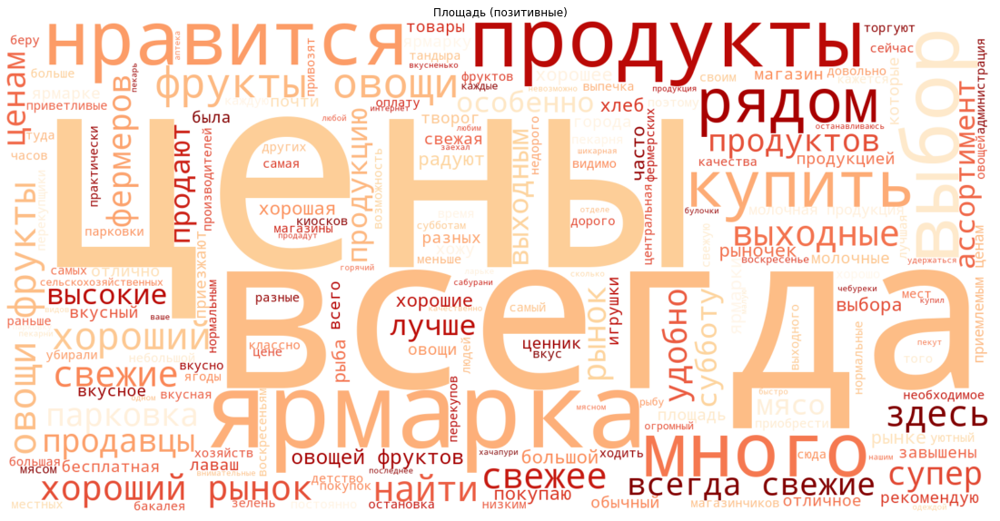

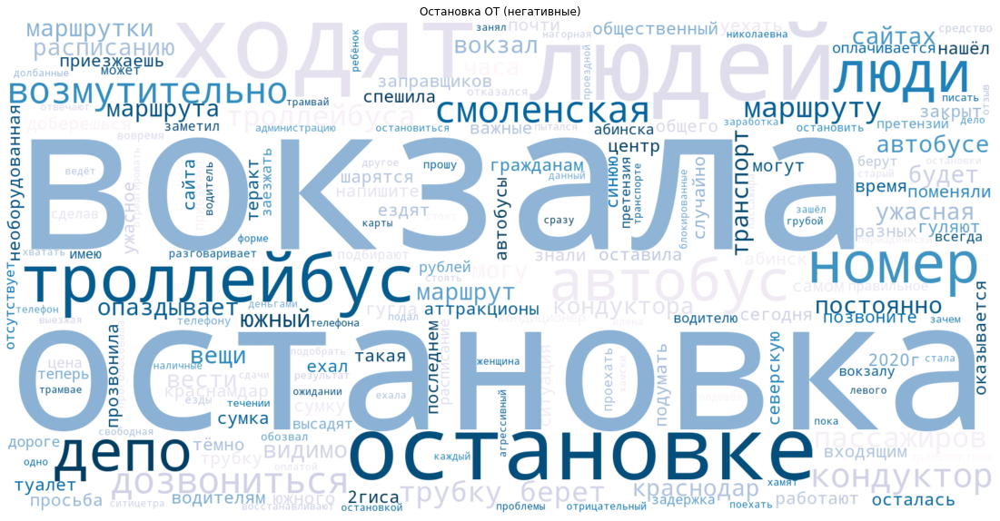

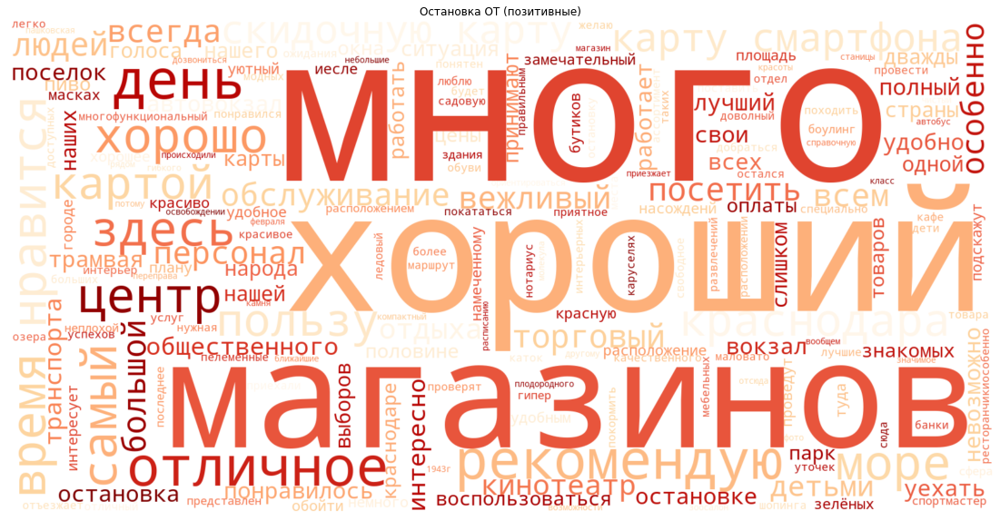

In [120]:
for i in words.loc[~words.category.isna()].category.drop_duplicates()[:-1]:
#     display(words.loc[((words.category==i) & (words.grammema.isin(g)) & (words.score<0)) , 'word'].value_counts()[:5])
    
    get_cloud(words.loc[((words.category==i) & (words.grammema.isin(g)) & (words.score<0)) , 'word'].to_list(), i+' (негативные)', 'PuBu')
    get_cloud(words.loc[((words.category==i) & (words.grammema.isin(g)) & (words.score>0)) , 'word'].to_list(), i+' (позитивные)', 'OrRd')

# Анализ биграмм

In [78]:
bigramms

,index_review,bigramm,word1,word2,tag1,tag2,url,score,positive,negative,comparative,category
0,207236,"('отличный', 'магазин')",отличный,магазин,ADJF,NOUN,https://www.google.com/maps/place/?q=place_id:...,8.3,8.3,0.0,2.075000,Магазин
1,207237,"('ужасный', 'обслуживание')",ужасный,обслуживание,ADJF,NOUN,https://www.google.com/maps/place/?q=place_id:...,-5.0,5.0,-10.0,-0.098039,Магазин
2,207237,"('обслуживание', 'магазин')",обслуживание,магазин,NOUN,NOUN,https://www.google.com/maps/place/?q=place_id:...,-5.0,5.0,-10.0,-0.098039,Магазин
3,207237,"('магазин', 'продавец')",магазин,продавец,NOUN,NOUN,https://www.google.com/maps/place/?q=place_id:...,-5.0,5.0,-10.0,-0.098039,Магазин
4,207237,"('продавец', 'вообще')",продавец,вообще,NOUN,ADVB,https://www.google.com/maps/place/?q=place_id:...,-5.0,5.0,-10.0,-0.098039,Магазин
...,...,...,...,...,...,...,...,...,...,...,...,...
1279680,336213,"('есть', 'выбор')",есть,выбор,INFN,NOUN,https://www.google.com/maps/place/?q=place_id:...,5.0,5.0,0.0,1.250000,Магазин
1279681,336214,"('большой', 'выбор')",большой,выбор,ADJF,NOUN,https://www.google.com/maps/place/?q=place_id:...,5.0,5.0,0.0,0.714286,Магазин
1279682,336214,"('выбор', 'качественный')",выбор,качественный,NOUN,ADJF,https://www.google.com/maps/place/?q=place_id:...,5.0,5.0,0.0,0.714286,Магазин
1279683,336214,"('качественный', 'обувь')",качественный,обувь,ADJF,NOUN,https://www.google.com/maps/place/?q=place_id:...,5.0,5.0,0.0,0.714286,Магазин


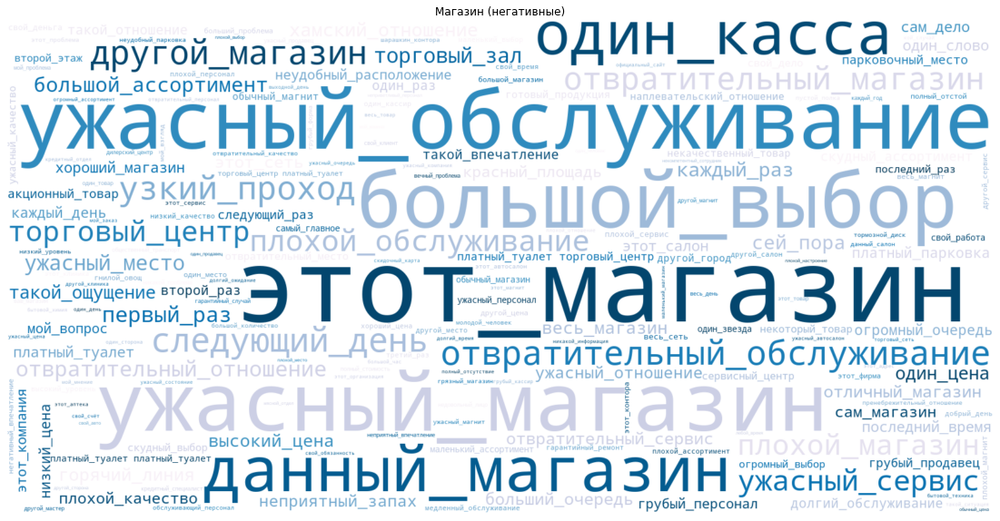

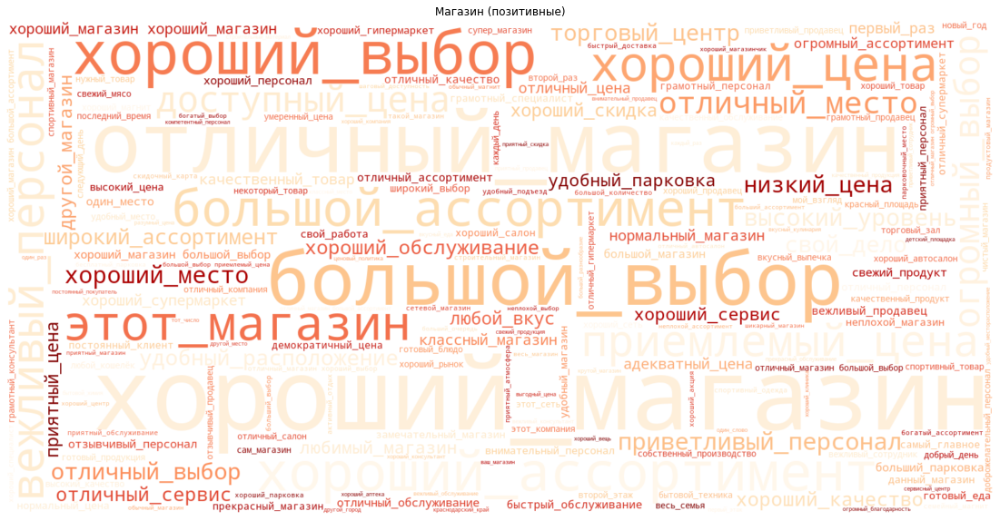

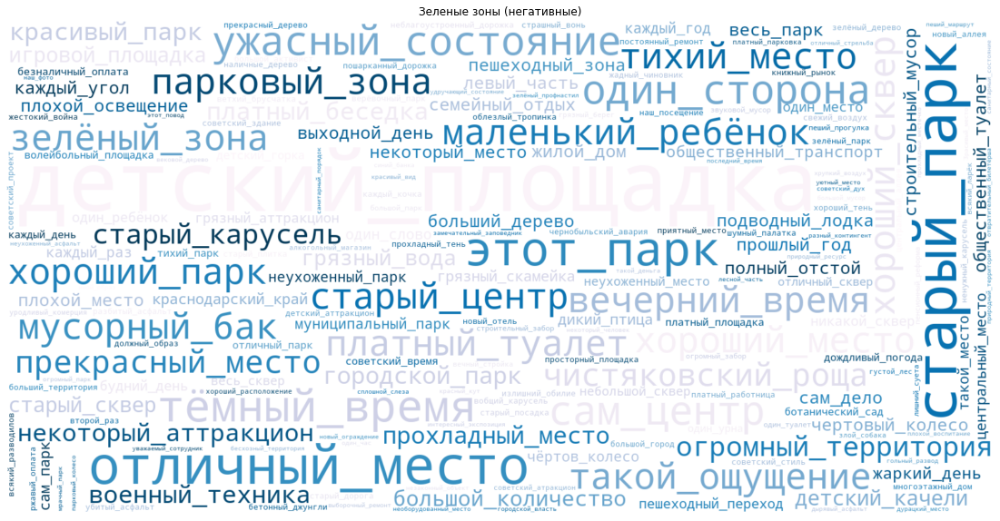

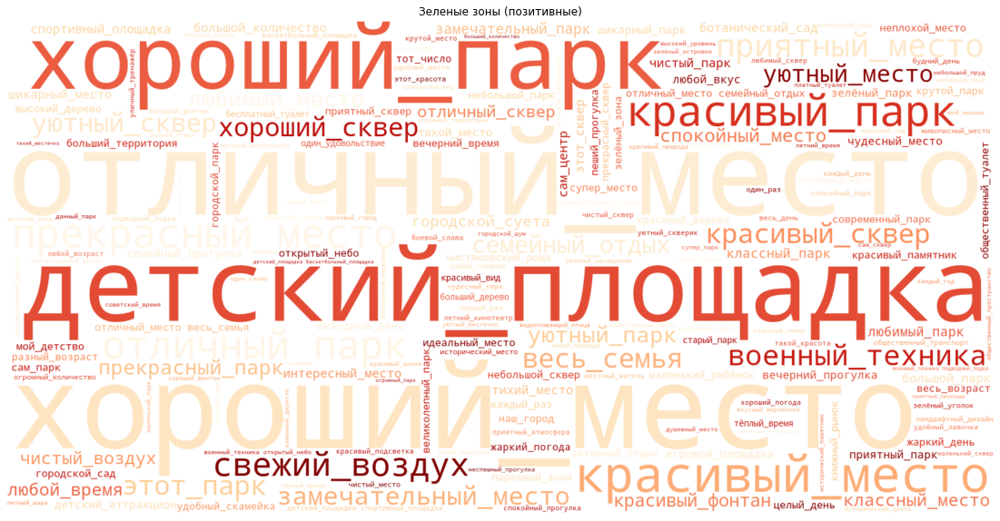

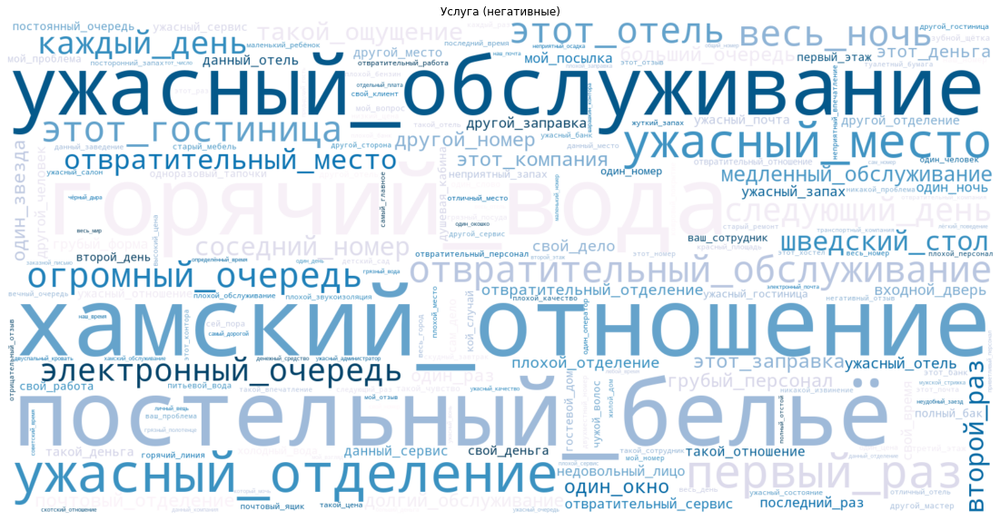

...

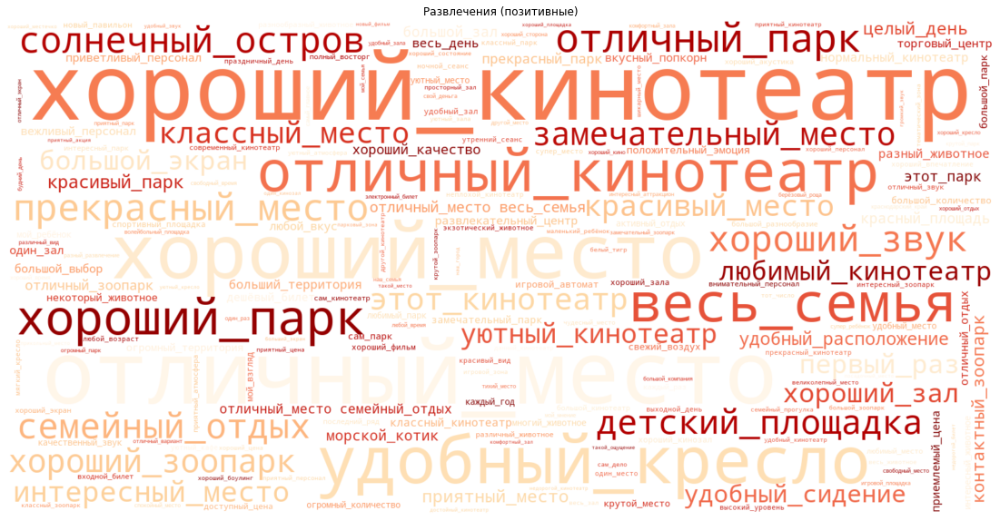

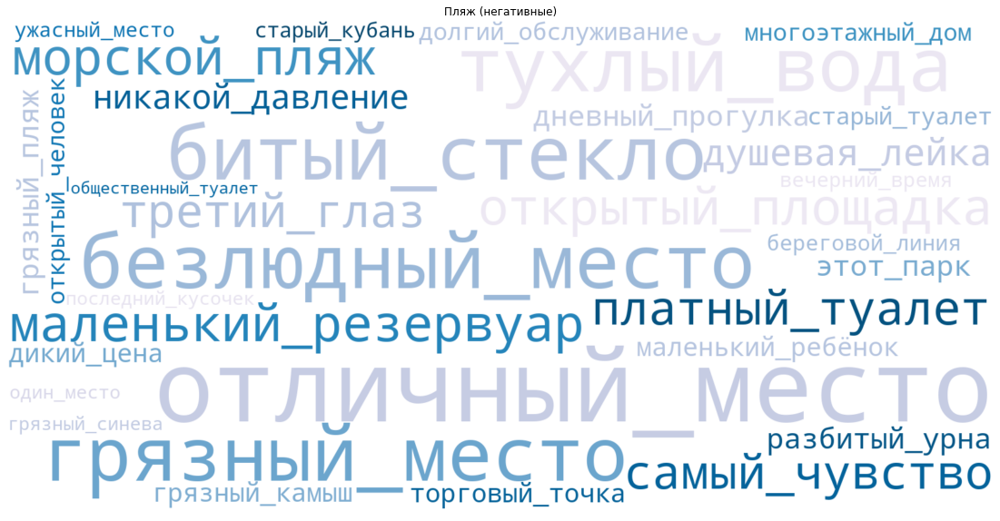

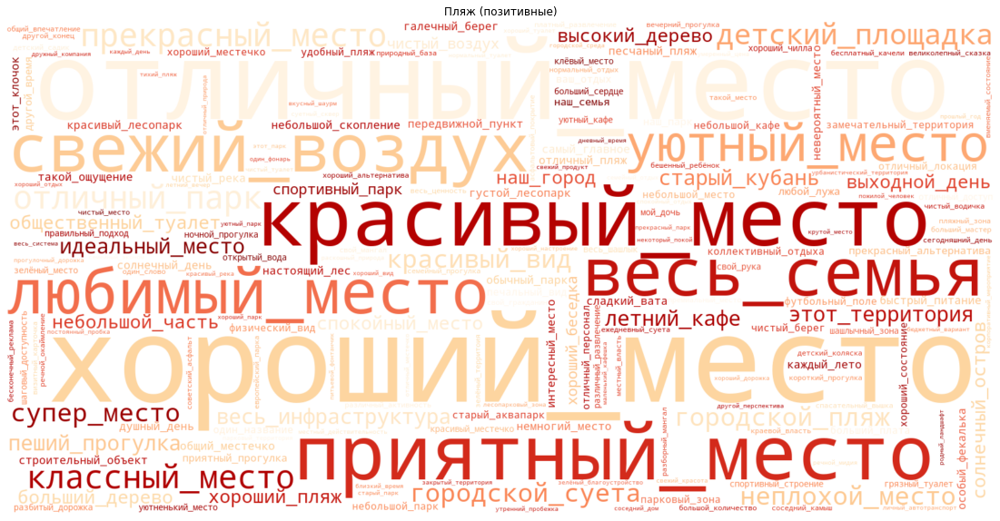

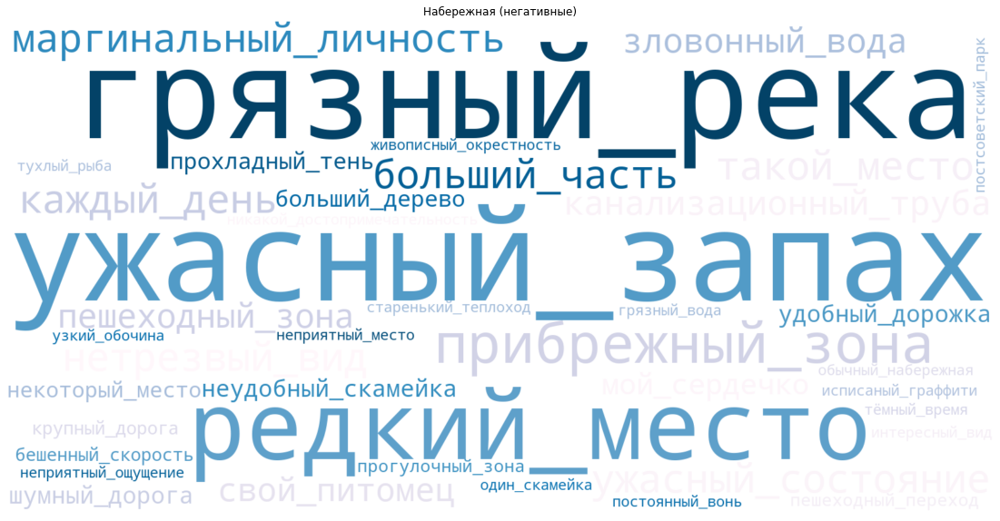

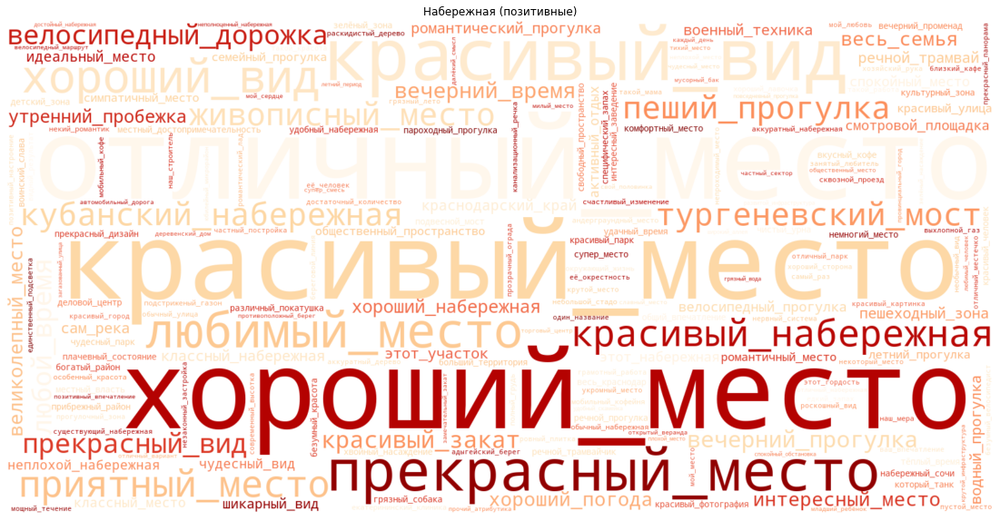

Локальность


In [121]:
for i in bigramms.loc[~bigramms.category.isna()].category.drop_duplicates():
    try:
        get_cloud(bigramms.loc[((bigramms.category==i) & (bigramms.tag1.isin(['ADJF', 'ADJS']))& (bigramms.tag2 == 'NOUN') & (bigramms.score<0)) , 'bigramm'].str[2:-2].str.split("', '").str.join('_').to_list(), i+' (негативные)', 'PuBu')
        get_cloud(bigramms.loc[((bigramms.category==i) & (bigramms.tag1.isin(['ADJF', 'ADJS']))& (bigramms.tag2 == 'NOUN') & (bigramms.score>0)) , 'bigramm'].str[2:-2].str.split("', '").str.join('_').to_list(), i+' (позитивные)', 'OrRd')
    
    except:
        print(i)

In [95]:
df = df.merge(places_df[['url', 'category']], how = 'left')

# Анализ сентиментов

In [204]:
print('Распределение среднего числа отзывов:')
display(places_df_sent.loc[places_df_sent.count_filled>0][['count_pos', 'count_neutral','count_neg']].mean())

Распределение среднего числа отзывов:


count_pos        20.262791
count_neutral     5.377061
count_neg         2.621376
dtype: float64

Text(0.5, 1.0, 'Распределение количества отзывов по сентиментам Аттракторов')

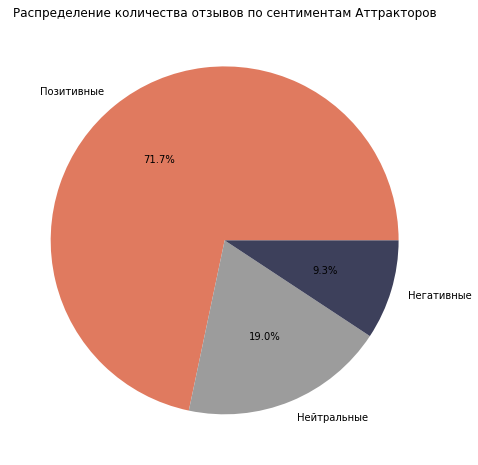

In [205]:
places_df_sent.loc[places_df_sent.count_filled>0][['count_pos', 'count_neutral','count_neg']].mean().plot(kind = 'pie', colors =[ "#E07A5F", "#9c9c9c","#3D405B"], labels = ['Позитивные', "Нейтральные", "Негативные"], figsize = (16, 8), autopct='%1.1f%%')
plt.ylabel('')
plt.title('Распределение количества отзывов по сентиментам Аттракторов')

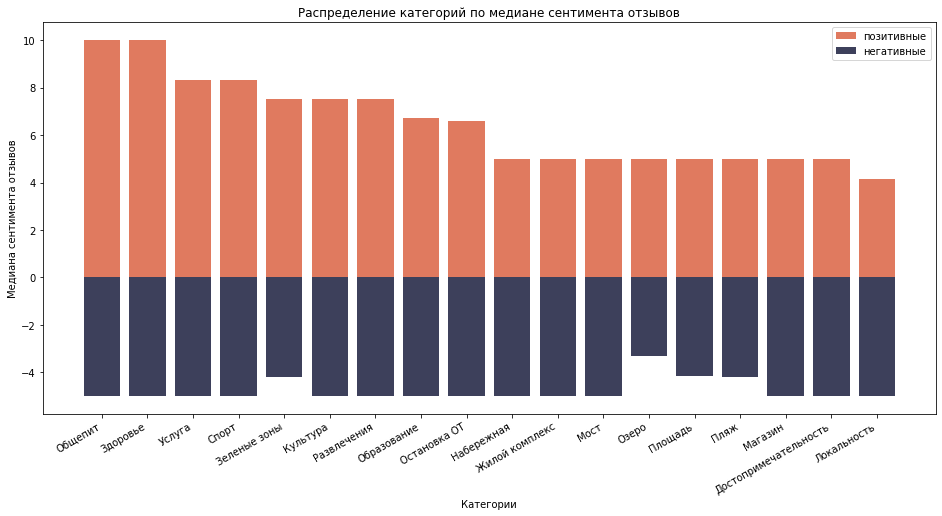

In [243]:
plot_df = df.loc[df.score>0].groupby('category').median()[['score']].rename(columns = {'score':'positive'}).reset_index().sort_values('positive', ascending = False).merge(
          df.loc[df.score<0].groupby('category').median()[['score']].rename(columns = {'score':'negative'}).reset_index(), how = 'left', on = 'category'
)
plt.figure(figsize = (16, 8))
ax = plt.subplot(111)
ax.bar(plot_df['category'],plot_df['positive'], color =["#E07A5F"])
ax.bar(plot_df['category'],plot_df['negative'], color =["#3D405B"])
plt.gcf().autofmt_xdate()
plt.xlabel('Категории')
plt.ylabel('Медиана сентимента отзывов')
plt.title('Распределение категорий по медиане сентимента отзывов')
plt.legend(['позитивные', "негативные"])

Text(0.5, 1.0, 'Распределение категорий по средней оценке сентимента отзывов')

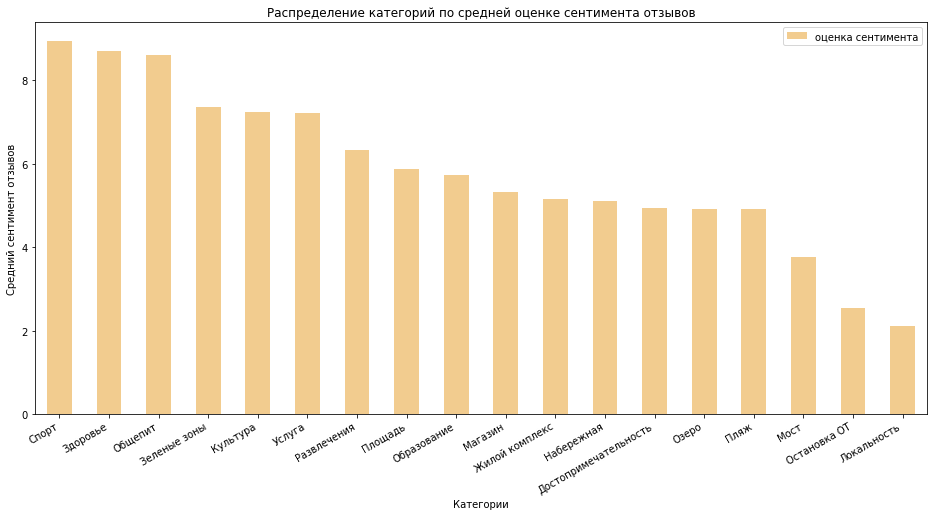

In [191]:
df.groupby('category').mean()[['score']].sort_values('score', ascending = False).plot.bar(color = ["#F2CC8F"],figsize = (16, 8))
plt.gcf().autofmt_xdate()
plt.xlabel('Категории')
plt.legend(['оценка сентимента'])
plt.ylabel('Средний сентимент отзывов')
plt.title('Распределение категорий по средней оценке сентимента отзывов')

Text(0.5, 1.0, 'Распределение отзывов по сентиментам')

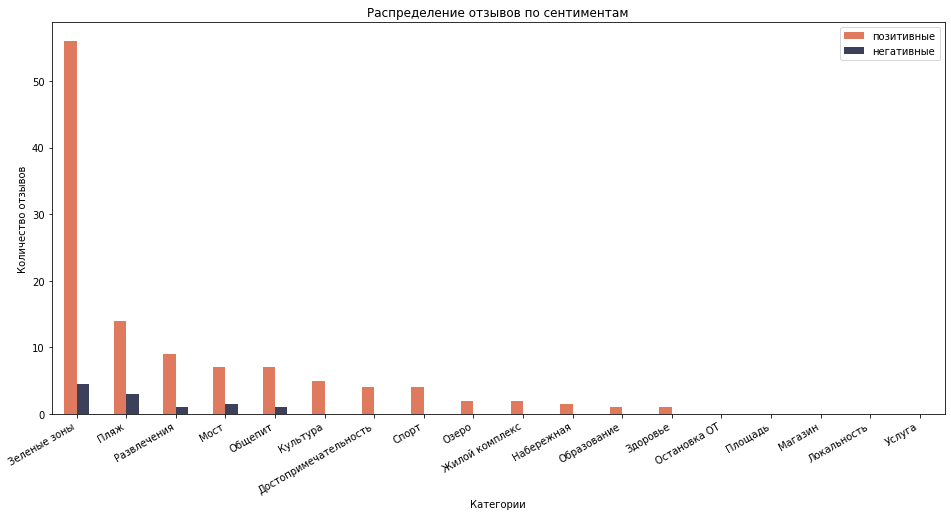

In [242]:
places_df_sent.groupby('category').median()[['count_pos', 'count_neg']].sort_values('count_pos', ascending = False)\
    .plot.bar(color =["#E07A5F", "#3D405B"],figsize = (16, 8))
plt.gcf().autofmt_xdate()
plt.xlabel('Категории')
plt.legend(['позитивные', "негативные"])
plt.ylabel('Количество отзывов')
plt.title('Распределение отзывов по сентиментам')

# Аттракторы

In [123]:
indexs = [1609,1616, 15198,15267,15248,15196,252,15233,15297,15207]

In [244]:
places_df_sent.loc[places_df_sent.index.isin(indexs)]

,url,title,address,type,popular_times_bars,geometry,types,rating,count_review,count_photo,...,normalized_rating,rating_by_category,count_downloaded,count_filled,count_pos,count_neg,count_neutral,median_score,median_negative,median_positive
252,https://www.google.com/maps/place/?q=place_id:...,"Городской сад, парк культуры и отдыха","ул. Постовая, 34, Краснодар, Краснодарский кра...",Парк,"['Загруженность в 06:00: 0%.', 'Загруженность ...",POINT (38.9699221 45.0105502),"['park', 'tourist_attraction', 'point_of_inter...",4.6,6826.0,5125.0,...,1.195743,1.195743,929.0,929.0,773.0,67.0,89.0,6.7,-5.0,7.5
1609,https://www.google.com/maps/place/?q=place_id:...,Парк «Краснодар»,"Краснодар, Краснодарский край, 350059",Парк,"['Загруженность в 04:00: 0%.', 'Загруженность ...",POINT (39.0317799 45.0416363),"['park', 'tourist_attraction', 'point_of_inter...",4.9,35831.0,60126.0,...,2.980000,2.980000,930.0,930.0,897.0,9.0,24.0,12.5,-5.0,12.5
1616,https://www.google.com/maps/place/?q=place_id:...,"Стадион ФК ""Краснодар""","ул. Разведчика Леонова, 1, Краснодар, Краснода...",Стадион,NaN,POINT (39.0291908 45.0444895),"['stadium', 'gym', 'health', 'point_of_interes...",4.9,25865.0,33754.0,...,2.263249,2.980000,930.0,930.0,869.0,21.0,40.0,10.0,-5.0,10.0
15196,https://www.google.com/maps/place/?q=place_id:...,Ботанический сад им. И.С. Косенко (Дендрарий),"ул. Калинина, 13, Краснодар, Краснодарский кра...",Ботанический сад,"['Загруженность в 05:00: 0%.', 'Загруженность ...",POINT (38.9293339 45.0541482),"['tourist_attraction', 'park', 'point_of_inter...",4.8,5265.0,6161.0,...,1.209408,1.209408,930.0,930.0,827.0,34.0,69.0,7.5,-4.2,8.3
15198,https://www.google.com/maps/place/?q=place_id:...,Чистяковская Роща,"ул. Колхозная, Краснодар, Краснодарский край, ...",Парк,"['Загруженность в 04:00: 1%.', 'Загруженность ...",POINT (38.9940405 45.05764529999999),"['park', 'tourist_attraction', 'point_of_inter...",4.6,20277.0,18542.0,...,1.794292,1.794292,930.0,930.0,804.0,47.0,79.0,6.7,-3.3,7.5
15207,https://www.google.com/maps/place/?q=place_id:...,Сквер им. Г.К. Жукова,"ул. Красная, Краснодар, Краснодарский край, 35...",Парк,"['Загруженность в 04:00: 1%.', 'Загруженность ...",POINT (38.9711376 45.0242461),"['park', 'tourist_attraction', 'point_of_inter...",4.7,6553.0,10395.0,...,1.295773,1.295773,929.0,929.0,812.0,28.0,89.0,5.8,-4.1,7.5
15233,https://www.google.com/maps/place/?q=place_id:...,Мост Поцелуев,"ул. Кубанонабережная, Краснодар, Краснодарский...",Мост,"['Загруженность в 04:00: 1%.', 'Загруженность ...",POINT (38.9577894 45.0253057),"['tourist_attraction', 'point_of_interest', 'e...",4.4,6223.0,4233.0,...,1.124079,2.956522,930.0,930.0,673.0,102.0,155.0,5.0,-5.0,7.5
15248,https://www.google.com/maps/place/?q=place_id:...,Екатерининский сквер,"Краснодар, Краснодарский край, 350063",Парк,"['Загруженность в 04:00: 1%.', 'Загруженность ...",POINT (38.9686925 45.0156085),"['park', 'tourist_attraction', 'point_of_inter...",4.8,4028.0,12028.0,...,1.272463,1.272463,930.0,930.0,821.0,20.0,89.0,5.8,-5.0,7.5
15267,https://www.google.com/maps/place/?q=place_id:...,Парк культуры и отдыха имени 30-летия Победы,"ул. Береговая, 146, Краснодар, Краснодарский к...",Парк,"['Загруженность в 04:00: 0%.', 'Загруженность ...",POINT (38.95178420000001 45.0169693),"['park', 'tourist_attraction', 'point_of_inter...",4.6,8236.0,18525.0,...,1.457960,1.457960,930.0,930.0,776.0,53.0,101.0,6.7,-5.0,7.5
15297,https://www.google.com/maps/place/?q=place_id:...,ЦПКиО им. Горького,"ул. Постовая, 34 строение 2, Краснодар, Красно...",Парк,"['Загруженность в 06:00: 0%.', 'Загруженность ...",POINT (38.970636 45.0120846),"['park', 'point_of_interest', 'establishment']",4.6,4542.0,12069.0,...,1.247490,1.247490,930.0,930.0,796.0,49.0,85.0,5.8,-3.3,7.5


In [245]:
places_df_sent.loc[places_df_sent.index.isin(indexs)].to_csv('../data/places_GP_attractors.csv', index = False)

Text(0.5, 1.0, 'Распределение отзывов по сентиментам')

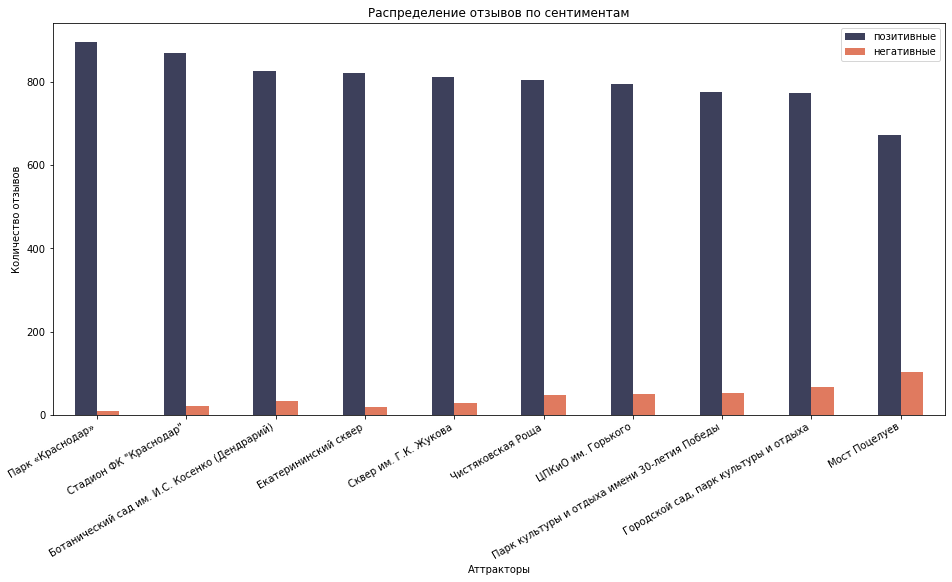

In [241]:
places_df_sent.loc[places_df_sent.index.isin(indexs)].set_index('title')[['count_pos', 'count_neg']].sort_values('count_pos', ascending = False)\
    .plot.bar(color =["#3D405B", "#E07A5F"],figsize = (16, 8))
plt.gcf().autofmt_xdate()
plt.xlabel('Аттракторы')
plt.ylabel('Количество отзывов')

plt.legend(['позитивные', "негативные"])
plt.title('Распределение отзывов по сентиментам')

In [236]:
places_df_sent.columns

Index(['url', 'title', 'address', 'type', 'popular_times_bars', 'geometry',
       'types', 'rating', 'count_review', 'count_photo', 'category_2',
       'category', 'normalized_rating', 'rating_by_category',
       'count_downloaded', 'count_filled', 'count_pos', 'count_neg',
       'count_neutral', 'median_score', 'median_negative', 'median_positive'],
      dtype='object')

Text(0.5, 1.0, 'Распределение отзывов по сентиментам')

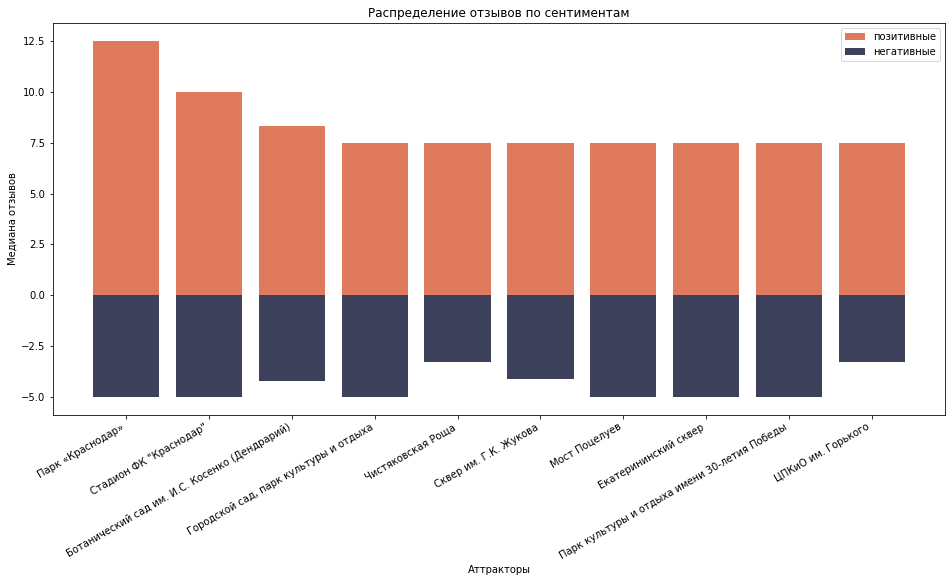

In [240]:
plot_df = places_df_sent.loc[places_df_sent.index.isin(indexs)][['title','median_positive', 'median_negative']].sort_values('median_positive', ascending = False)

plt.figure(figsize = (16, 8))
ax = plt.subplot(111)
ax.bar(plot_df['title'],plot_df['median_positive'], color =["#E07A5F"])
ax.bar(plot_df['title'],plot_df['median_negative'], color =["#3D405B"])
plt.gcf().autofmt_xdate()
plt.xlabel('Аттракторы')
plt.ylabel('Медиана отзывов')
plt.legend(['позитивные', "негативные"])
plt.title('Распределение отзывов по сентиментам')

Text(0.5, 1.0, 'Распределение количества отзывов по сентиментам Аттракторов')

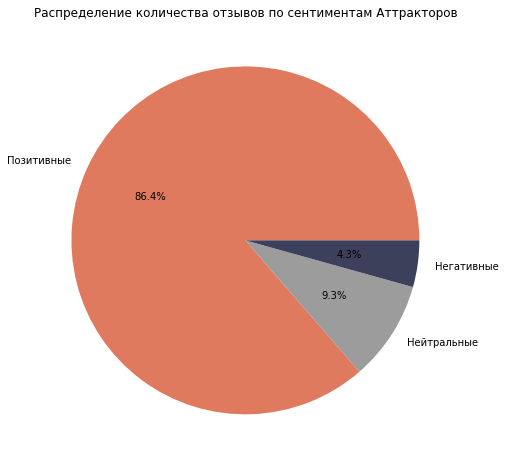

In [149]:
places_df_sent.loc[places_df_sent.index.isin(indexs)][['count_pos', 'count_neutral','count_neg']].median().plot(kind = 'pie', colors =[ "#E07A5F", "#9c9c9c","#3D405B"], labels = ['Позитивные', "Нейтральные", "Негативные"], figsize = (16, 8), autopct='%1.1f%%')
plt.ylabel('')
plt.title('Распределение количества отзывов по сентиментам Аттракторов')

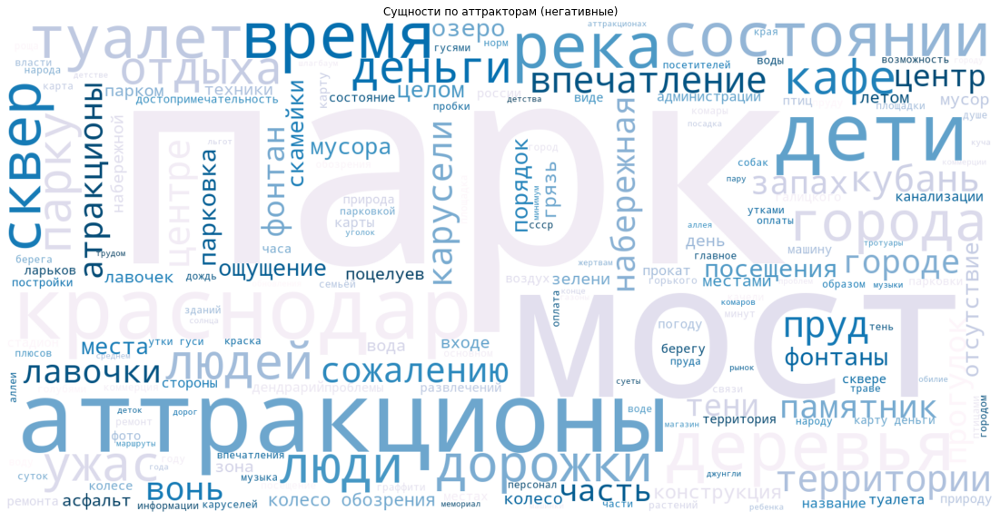

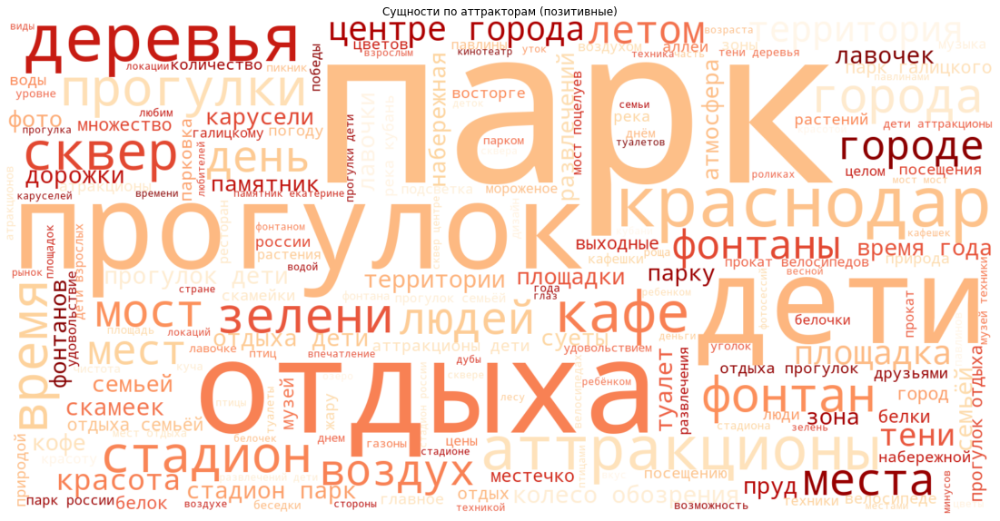

In [218]:
attractors_w = words.loc[words.url.isin(places_df_sent.loc[places_df_sent.index.isin(indexs), 'url'])]
get_cloud(attractors_w.loc[((attractors_w.grammema == 'NOUN') & (attractors_w.score<0)) , 'word'].to_list(), 'Сущности по аттракторам (негативные)', 'PuBu')
get_cloud(attractors_w.loc[((attractors_w.grammema == 'NOUN') & (attractors_w.score>0)) , 'word'].to_list(), 'Сущности по аттракторам (позитивные)', 'OrRd')

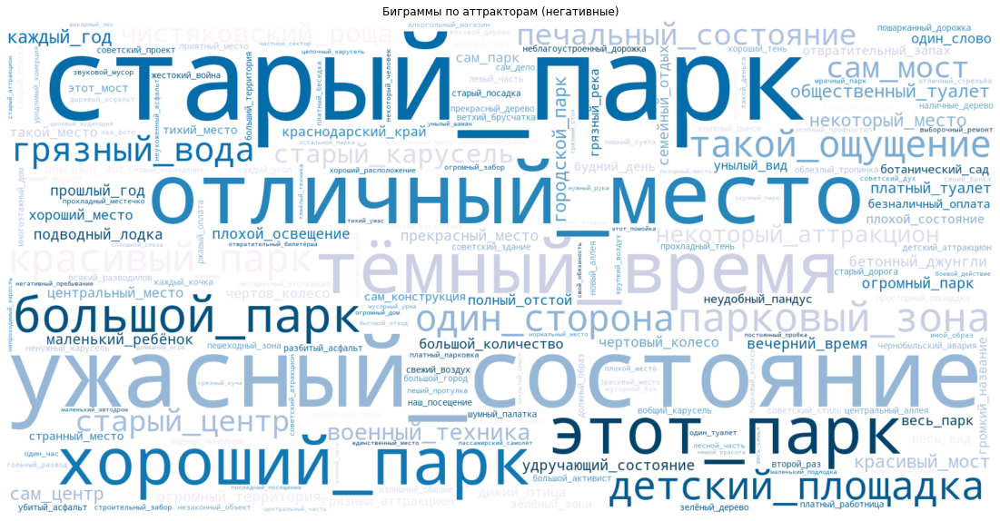

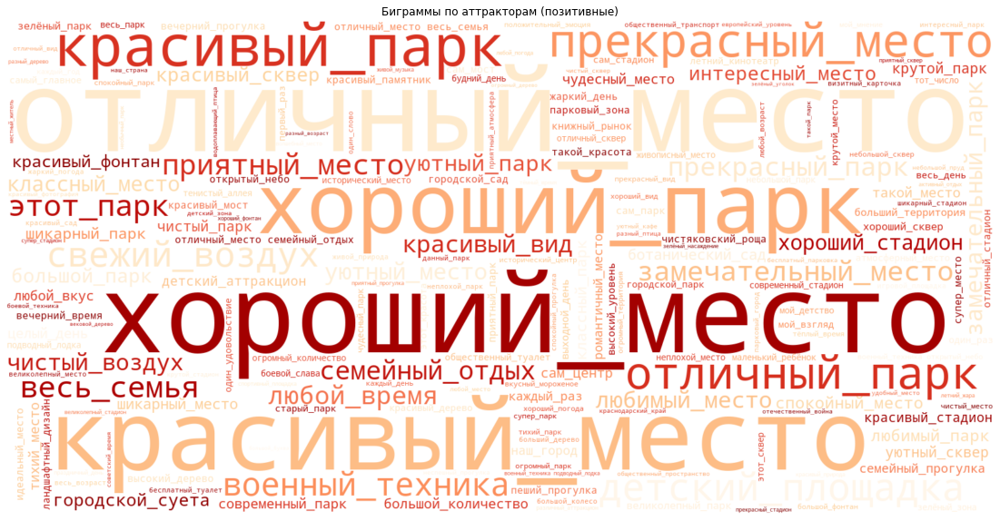

In [208]:
attractors_b = bigramms.loc[bigramms.url.isin(places_df_sent.loc[places_df_sent.index.isin(indexs), 'url'])]
get_cloud(attractors_b.loc[((attractors_b.tag1.isin(['ADJF', 'ADJS']))& (attractors_b.tag2 == 'NOUN') & (attractors_b.score<0)) , 'bigramm'].str[2:-2].str.split("', '").str.join('_').to_list(), 'Биграммы по аттракторам (негативные)', 'PuBu')
get_cloud(attractors_b.loc[((attractors_b.tag1.isin(['ADJF', 'ADJS']))& (attractors_b.tag2 == 'NOUN') & (attractors_b.score>0)) , 'bigramm'].str[2:-2].str.split("', '").str.join('_').to_list(), 'Биграммы по аттракторам (позитивные)', 'OrRd')